In [1]:
import gensim
gensim.__version__

'4.3.3'

# Chargement et nettoyage

### Lecture et parsing du fichier XML

In [2]:
#numpy
import numpy

#modification du dossier de travail
import os
os.chdir("C:/Users/Thibaud/Desktop/NLP/radar-nlp/data")

corpus_original = []
#parsage du fichier XML
import csv
with open('jobs_normalized.csv', mode ='r')as file:
  csvFile = csv.reader(file)
  for lines in csvFile:
        print(lines[11])
        corpus_original.append(lines[11])

raw_text
Missions: Définir des stratégies de sélection d'images destinées à l'entraînement de modèles de deep learning, en lien avec les besoins de projets IA Vérifier la cohérence et la qualité générale des données Analyser l'impact des données sur les performances et la robustesse des modèles Collaborer avec des équipes techniques et métiers impliquées dans le développement de solutions IA Profil recherché: Connaissances en deep learning (TensorFlow, PyTorch) et en analyse de données Rigueur et sens du détail Intérêt pour la recherche Formation bac+5 voire doctorat en computer science
Introduction Travailler chez Lidl, c'est bien plus qu'un job ! En rejoignant l'équipe Data & AI au sein du service contrôle de gestion, tu participeras à l'amélioration de l'activité de Lidl France à travers des projets data science à fort impact opérationnel. Missions Afin d'atteindre tes objectifs en tant que Data Scientist, tes missions quotidiennes seront : - Collaborer avec les services métier pour

Mission : Ce poste s'inscrit dans le cadre du projet PUMA (PEPR PROPSY), qui vise à étudier les liens entre qualité de l'air et santé mentale. Il s'agit d'une cohorte de 300 participant·es portera des capteurs de qualité de l'air pendant 2-3 semaines, avec rotation, pendant 2 ans. Les missions sont d'assurer (1) la logistique autour d'une flotte de capteurs de qualité de l'air (envoi, réception, recalibration), en lien avec les différents partenaires, et (2) la constitution d'une base de données sur la qualité de l'air (extraction, mise en forme, prétraitrements) et sa première analyse. Activités : - Activité 1 : assurer la logistique d'acquisition et d'envoi des capteurs en lien avec les chercheurs et les services administratifs des différents labos partenaires, impliqués dans le volet capteur, - Activité 2 : pour le capteur passif de NO2 dont le temps d'utilisation est limité, envoyer à un laboratoire extérieur au consortium pour analyse, - Activité 3 : participer à la définition du 

In [3]:
# on retire le premier car header
corpus_original.pop(0)
print(corpus_original)

["Missions: Définir des stratégies de sélection d'images destinées à l'entraînement de modèles de deep learning, en lien avec les besoins de projets IA Vérifier la cohérence et la qualité générale des données Analyser l'impact des données sur les performances et la robustesse des modèles Collaborer avec des équipes techniques et métiers impliquées dans le développement de solutions IA Profil recherché: Connaissances en deep learning (TensorFlow, PyTorch) et en analyse de données Rigueur et sens du détail Intérêt pour la recherche Formation bac+5 voire doctorat en computer science", "Introduction Travailler chez Lidl, c'est bien plus qu'un job ! En rejoignant l'équipe Data & AI au sein du service contrôle de gestion, tu participeras à l'amélioration de l'activité de Lidl France à travers des projets data science à fort impact opérationnel. Missions Afin d'atteindre tes objectifs en tant que Data Scientist, tes missions quotidiennes seront : - Collaborer avec les services métier pour com

In [4]:
#nombre d'items chargés    
print(len(corpus_original))

#vérification pour le premier item
print(corpus_original[0])

#vérification pour le dernier item
print(corpus_original[-1])

18057
Missions: Définir des stratégies de sélection d'images destinées à l'entraînement de modèles de deep learning, en lien avec les besoins de projets IA Vérifier la cohérence et la qualité générale des données Analyser l'impact des données sur les performances et la robustesse des modèles Collaborer avec des équipes techniques et métiers impliquées dans le développement de solutions IA Profil recherché: Connaissances en deep learning (TensorFlow, PyTorch) et en analyse de données Rigueur et sens du détail Intérêt pour la recherche Formation bac+5 voire doctorat en computer science
Vous aimez tisser des liens? Vous aimez œuvrer pour le bien-être des gens ? Nous avons du travail pour vous ! Appel Médical, chaque jour, à vos côtés dans les métiers de la santé. Une équipe dédiée au secteur de la santé rien que pour vous. Comment souhaiteriez-vous transformer le quotidien des résidents en tant qu'Aide-soignant(e) en établissement médico-social ? Rejoignez notre équipe dynamique pour four

### Nettoyage, préparation du corpus

In [5]:
#récupérer la liste des ponctuations
import string
ponctuations = list(string.punctuation)
print(ponctuations)

#liste des chiffres
chiffres = list("0123456789")
print(chiffres)

#outil pour procéder à la lemmatisation - attention à charger le cas échéant
#nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer
lem = WordNetLemmatizer()

#pour la tokénisation
from nltk.tokenize import word_tokenize

#liste des mots vides
from nltk.corpus import stopwords
mots_vides = stopwords.words("french")
print(mots_vides)

['!', '"', '#', '$', '%', '&', "'", '(', ')', '*', '+', ',', '-', '.', '/', ':', ';', '<', '=', '>', '?', '@', '[', '\\', ']', '^', '_', '`', '{', '|', '}', '~']
['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']
['au', 'aux', 'avec', 'ce', 'ces', 'dans', 'de', 'des', 'du', 'elle', 'en', 'et', 'eux', 'il', 'ils', 'je', 'la', 'le', 'les', 'leur', 'lui', 'ma', 'mais', 'me', 'même', 'mes', 'moi', 'mon', 'ne', 'nos', 'notre', 'nous', 'on', 'ou', 'par', 'pas', 'pour', 'qu', 'que', 'qui', 'sa', 'se', 'ses', 'son', 'sur', 'ta', 'te', 'tes', 'toi', 'ton', 'tu', 'un', 'une', 'vos', 'votre', 'vous', 'c', 'd', 'j', 'l', 'à', 'm', 'n', 's', 't', 'y', 'été', 'étée', 'étées', 'étés', 'étant', 'étante', 'étants', 'étantes', 'suis', 'es', 'est', 'sommes', 'êtes', 'sont', 'serai', 'seras', 'sera', 'serons', 'serez', 'seront', 'serais', 'serait', 'serions', 'seriez', 'seraient', 'étais', 'était', 'étions', 'étiez', 'étaient', 'fus', 'fut', 'fûmes', 'fûtes', 'furent', 'sois', 'soit', 'soyons', 'soyez', '

In [6]:
#********************************
#fonction pour nettoyage document (chaîne de caractères)
#le document revient sous la forme d'une liste de tokens
#********************************
def nettoyage_doc(doc_param):
    #passage en minuscule
    doc = doc_param.lower()
    #retrait des ponctuations
    doc = "".join([w for w in list(doc) if not w in ponctuations])
    #retirer les chiffres
    doc = "".join([w for w in list(doc) if not w in chiffres])
    #transformer le document en liste de termes par tokénisation
    doc = word_tokenize(doc)
    #lematisation de chaque terme
    doc = [lem.lemmatize(terme) for terme in doc]
    #retirer les stopwords
    doc = [w for w in doc if not w in mots_vides]
    #retirer les termes de moins de 3 caractères
    doc = [w for w in doc if len(w)>=3]
    #fin
    return doc

In [7]:
#************************************************************
#fonction pour nettoyage corpus
#attention, optionnellement les documents vides sont éliminés
#************************************************************
def nettoyage_corpus(corpus,vire_vide=True):
    #output
    output = [nettoyage_doc(doc) for doc in corpus if ((len(doc) > 0) or (vire_vide == False))]
    return output

In [8]:
#nombre de docs avant nettoyage
print("Nombre de docs AVANT filtrage vide = {}".format(len(corpus_original)))

#corpus après pré-traitement, sous forme de liste de listes de tokens
corpus_liste = nettoyage_corpus(corpus_original)

#nombre de docs après filtrage
print("Nombre de docs APRES nettoyage = {}".format(len(corpus_liste)))

#reformer les documents pour vérification
corpus_final = [" ".join(doc) for doc in corpus_liste]
print(corpus_final[0])

#par comparaison
print(corpus_original[0])

Nombre de docs AVANT filtrage vide = 18057


Nombre de docs APRES nettoyage = 18057
mission définir stratégies sélection dimages destinées lentraînement modèles deep learning lien besoins projets vérifier cohérence qualité générale données analyser limpact données performance robustesse modèles collaborer équipes technique métiers impliquées développement solution profil recherché connaissances deep learning tensorflow pytorch analyse données rigueur sen détail intérêt recherche formation bac voire doctorat computer science
Missions: Définir des stratégies de sélection d'images destinées à l'entraînement de modèles de deep learning, en lien avec les besoins de projets IA Vérifier la cohérence et la qualité générale des données Analyser l'impact des données sur les performances et la robustesse des modèles Collaborer avec des équipes techniques et métiers impliquées dans le développement de solutions IA Profil recherché: Connaissances en deep learning (TensorFlow, PyTorch) et en analyse de données Rigueur et sens du détail Intérêt

# Entraînement représentation Doc2Vec

In [9]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

documents = [
    TaggedDocument(words=doc, tags=[i])
    for i, doc in enumerate(corpus_final)
]

model_doc2vec = Doc2Vec(
    documents,
    vector_size=100,
    window=5,
    min_count=2,
    epochs=40
)


In [10]:
import numpy as np

doc_embeddings = np.array([
    model_doc2vec.dv[i]
    for i in range(len(model_doc2vec.dv))
])


In [11]:
doc_embeddings.shape

(18057, 100)

In [12]:
from sklearn.manifold import TSNE

tsne = TSNE(
    n_components=2,
    perplexity=30,
    random_state=42,
    n_iter=1000
)

docs_2d = tsne.fit_transform(doc_embeddings)


d:\anaconda3\envs\envtd_pretrained\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


In [13]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=10, random_state=42)
clusters = kmeans.fit_predict(doc_embeddings)

In [14]:
print(clusters)

[3 3 5 ... 9 9 9]


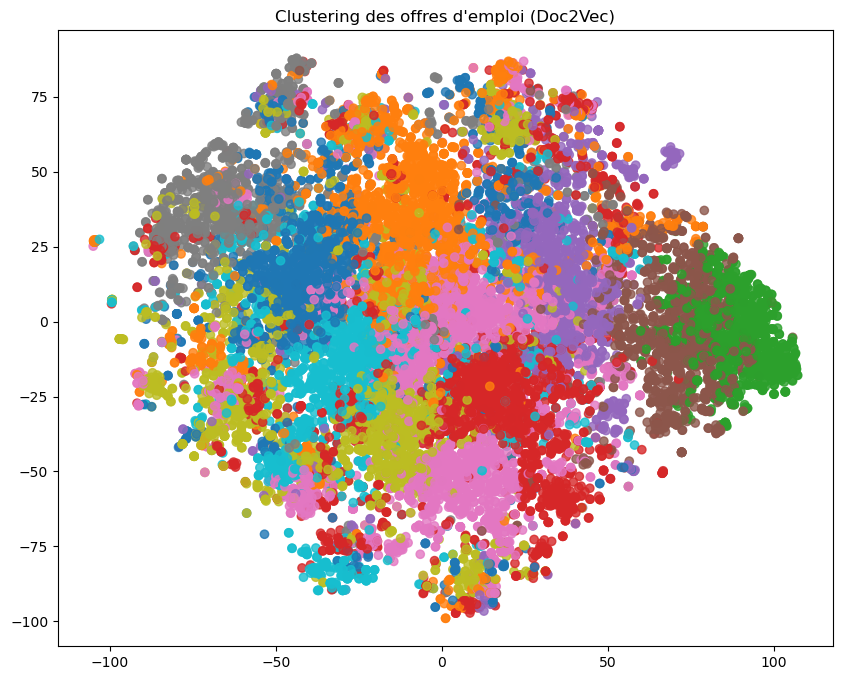

In [15]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
plt.scatter(
    docs_2d[:, 0],
    docs_2d[:, 1],
    c=clusters,
    cmap='tab10',
    alpha=0.8,
)
plt.title("Clustering des offres d'emploi (Doc2Vec)")
plt.show()


In [16]:
from sklearn.metrics import silhouette_score

silhouette_score(doc_embeddings, clusters)


0.03155025

In [17]:
model_doc2vec.dv.most_similar(0)

[(17, 0.7140011191368103),
 (525, 0.639375627040863),
 (10479, 0.6191162467002869),
 (10084, 0.6130032539367676),
 (8092, 0.5893753170967102),
 (337, 0.5822027325630188),
 (5267, 0.5809176564216614),
 (8806, 0.5809115171432495),
 (9, 0.5745347142219543),
 (12908, 0.5627505779266357)]

# Entraînement représentation Word2Vec

In [18]:
#word2vec de Gensim
from gensim.models import Word2Vec
modele = Word2Vec(corpus_liste,vector_size=2,window=3,min_count=1,epochs=10,seed=1)
print(type(modele))

#dimensionnalité
print(modele.vector_size)

<class 'gensim.models.word2vec.Word2Vec'>
2


In [19]:
#taille du voisinage
modele.window

3

In [20]:
#propriété "wv" -> wordvector
words = modele.wv

#dimension de la représentation
words.vectors.shape

(41406, 2)

In [21]:
#affichage des termes de leur index
words.key_to_index

#taille du dictionnaire
len(words.key_to_index)

41406

In [22]:
#les clés : les termes
list(words.key_to_index.keys())[:20]

['data',
 'mission',
 'client',
 'and',
 'données',
 'offres',
 'salaire',
 'emploi',
 'profil',
 'plus',
 'the',
 'offre',
 'solution',
 'poste',
 'lapp',
 'service',
 'stage',
 'cette',
 'formation',
 'candidature']

In [23]:
#vérifier que data fait partie des termes
print("data" in words.key_to_index.keys())

#vérifier que ia fait partie des termes
print("python" in words.key_to_index.keys())

True
True


In [24]:
#vérifier que "data" fait partie des termes
print("data" in words.key_to_index.keys())

#coordonnées de data
print(words["data"])


True
[2.3678958  0.09102479]


In [25]:
#coordonnées de python
words["python"]

array([ 4.0194626, -1.711513 ], dtype=float32)

In [26]:
#similarité entre agent et python
words.similarity("agent","python")

0.9914273

In [27]:
#vérifier manuellement le calcul
def my_cosinus(vec1,vec2):
    res = numpy.dot(vec1,vec2)/(numpy.linalg.norm(vec1)*numpy.linalg.norm(vec2))
    return res

In [28]:
#appel de ma fonction cosinus - comparaison avec similarity()
my_cosinus(words["python"],words["agent"])

0.9914273

In [29]:
#les termes les plus proches de "fun"
words.most_similar("python",topn=5)

[('creation', 1.0000001192092896),
 ('respectful', 1.0),
 ('function', 1.0),
 ('aqemia', 1.0),
 ('imputation', 1.0)]

In [30]:
#les plus similaires de la conjonction "fun" et "performance"
words.most_similar(positive=["python","data"],topn=5)

[('frame', 1.0000001192092896),
 ('escalation', 1.0000001192092896),
 ('igr', 1.0000001192092896),
 ('frigoriste', 1.0000001192092896),
 ('infor', 1.0)]

In [31]:
#proche de "fun" mais loin de "performance"
print(words.most_similar(positive=["data"],negative=["python"],topn=5))

[('contribuez…', 1.0), ('fitting', 1.0), ('niveau', 1.0), ('communiqué', 0.9999999403953552), ('santé', 0.9999999403953552)]


In [32]:
#chercher l'intrus
liste = ['data','python','agent']
words.doesnt_match(liste)

'data'

In [33]:
#data frame des coordonnées
import pandas
df = pandas.DataFrame(words.vectors,columns=['V1','V2'],index=words.key_to_index.keys())
df.head()

,V1,V2
data,2.367896,0.091025
mission,1.205222,1.832974
client,1.054493,2.136062
and,10.595448,-5.071599
données,2.281052,0.270024


In [34]:
#sous-data frame corresp. aux termes à étudier
dfListe = df.loc[liste]
dfListe

,V1,V2
data,2.367896,0.091025
python,4.019463,-1.711513
agent,2.002410,-0.557461


C:\Users\Thibaud\AppData\Local\Temp\ipykernel_13456\3591773974.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plt.annotate(dfListe.index[i],(dfListe.V1[i],dfListe.V2[i]))


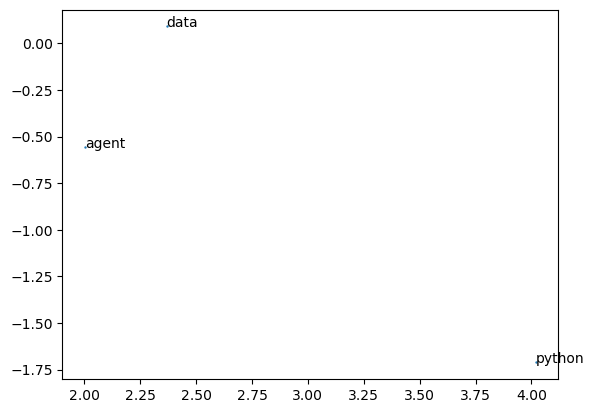

In [35]:
#graphique dans le plan
import matplotlib.pyplot as plt
plt.scatter(dfListe.V1,dfListe.V2,s=0.5)
for i in range(dfListe.shape[0]):
    plt.annotate(dfListe.index[i],(dfListe.V1[i],dfListe.V2[i]))
plt.show()

# Représentation pré-entraînée Wikipedia

### Chargement et inspection

In [36]:
#autre représentation pré-entraînée
#https://wikipedia2vec.github.io/wikipedia2vec/pretrained/
from gensim.models import keyedvectors
pretrained = keyedvectors.load_word2vec_format("frwiki_20180420_100d.txt.bz2",binary=False,unicode_errors='ignore')

In [37]:
#type de l'objet
type(pretrained)

gensim.models.keyedvectors.KeyedVectors

In [38]:
#dimension de représentation
print(pretrained.vector_size)

100


In [39]:
#taille du dictionnaire
print(len(pretrained.key_to_index))

2500733


In [40]:
#20 premiers termes du dictionnaire
dico = list(pretrained.key_to_index.keys())
print(dico[:20])

['de', 'est', 'la', 'le', 'en', 'et', 'à', 'du', 'un', 'des', 'dans', 'une', 'les', 'au', 'par', 'il', 'pour', 'sur', 'a', 'qui']


In [41]:
#dimension de la matrice de coordonnées
print(pretrained.vectors.shape)

(2500733, 100)


In [42]:
#exemple type du roi et de la reine
print(pretrained.most_similar(positive=['king','woman'],negative=['man']))

[('queen', 0.7401574850082397), ('lady', 0.7321710586547852), ('jilt', 0.7215192914009094), ('marmee', 0.7203415632247925), ('wetona', 0.7031170725822449), ('nesby', 0.6966132521629333), ('unfulfilled', 0.6939131021499634), ('syrett', 0.69163578748703), ('limberlost', 0.6904241442680359), ('kimara', 0.6888993382453918)]


In [43]:
#yaris est dans le dictionnaire ?
print('data' in dico)

True


In [44]:
#toyota dans le dictionnaire ?
print('python' in dico)

True


In [45]:
#coordonnées de toyota
print(pretrained['data'])

[ 0.0335  1.0737  0.2351 -0.3581 -0.3492  0.1512  1.0882 -0.0585  0.5963
  0.8603  0.0498 -0.2465 -0.3817  0.5113 -0.8948  1.2829  0.2198  0.3568
 -0.6108 -0.8979 -0.3353 -0.2561  0.1792  0.3725  0.6506 -0.359  -0.3073
  0.1319 -0.587  -0.9204 -0.6168  0.3726  0.2321 -0.1203  0.9523 -0.2385
 -1.1113 -0.234   0.4214 -0.4564  0.43    0.3483 -0.2418 -0.4441  0.1769
  0.4344  0.0592  0.3697 -0.4008 -0.066  -0.2458  0.2807  0.4082 -0.2499
  0.5214  0.5272  0.3631 -0.0073 -1.2073 -1.1606 -0.4636 -0.1339  0.2452
  0.7787  0.4167 -0.8225  0.1013  0.7828  0.6173  0.555  -0.7077 -0.7496
 -0.6591  0.5587  0.2356 -0.2924  0.1564  0.3096  0.0301 -0.4771  0.6664
  0.306   0.8239  0.212  -1.2155  0.4687 -0.3187 -0.1582 -0.1445  0.7599
  0.1328  0.7781  0.4599 -1.0631  0.588  -0.0172  0.8267  0.0571  0.2027
 -1.3916]


In [46]:
#termes proches de toyota
print(pretrained.most_similar('data',topn=5))

[('value', 0.8981150984764099), ('sort', 0.7568819522857666), ('jxp', 0.7464837431907654), ('jrv', 0.7444959878921509), ('jxv', 0.7397143840789795)]


In [47]:
#proche de toyota et yaris
print(pretrained.most_similar(positive=["data","python"]))

[('bcel', 0.7567961812019348), ('jdo', 0.753225564956665), ('libgnufdisk', 0.7529758214950562), ('clob', 0.7444207072257996), ('caching', 0.7359687685966492), ('jdk', 0.7334760427474976), ('stackless', 0.7326063513755798), ('jmx', 0.7310765981674194), ('jdj', 0.7309854030609131), ('mxml', 0.7277683615684509)]


In [48]:
#proche de toyota mais loin de yaris
print(pretrained.most_similar(positive=["data"],negative=["python"]))

[('value', 0.6002339720726013), ('jxp', 0.4603622555732727), ('sort', 0.4574523866176605), ('jxv', 0.4564161002635956), ('jxr', 0.45123836398124695), ('jxw', 0.4443466067314148), ('jxs', 0.44218114018440247), ('jxz', 0.4409988224506378), ('jxt', 0.43913325667381287), ('jtt', 0.43782487511634827)]


### Word2Vec from scratch, même dimension

In [49]:
#reconstruire une représentation entraînée aux mêmes dimensions
modeleBis = Word2Vec(corpus_liste,vector_size=pretrained.vector_size,window=3,min_count=1,epochs=10,seed=1)
wordsBis = modeleBis.wv

In [50]:

#coordonnées de toyota
print(wordsBis['data'])

[-0.32836932 -0.4837467  -0.08419773 -0.77769613 -1.6808583   0.23002236
 -0.7217433  -0.4820018   2.2971573  -0.8706328   0.4007247   0.846646
 -1.80238     0.1613529  -1.9969369  -1.7778853  -0.04022637  0.64832425
 -1.7605239  -1.8729633  -0.99349666  0.6989586   2.620603    1.1620885
  0.22118701 -0.7427731   1.8182563   1.1467817   1.4602667  -2.043644
 -0.22950698  0.21284573  2.2797463   0.22188146 -0.88328    -0.42318666
  2.1577833  -1.1530142   1.9749467   0.695824    0.12374441  0.75657386
 -2.2235882   0.3138699   0.28450322  0.81007403 -0.6188219   1.7643831
 -1.4465083   0.7445993  -2.9225597   1.805482    0.39647448  0.85583496
  2.207088   -1.4235071   0.08328579 -1.1508733  -1.3346465  -0.68776596
 -0.8108337   0.11453056 -3.6834538  -1.251894    2.09743     0.36512256
  2.5761642   0.8686327   0.7490186   1.1377342   0.9015593   1.0074627
 -1.4272784  -0.04554779 -0.5900531  -0.75551665  1.0991868   0.651669
 -0.26656672  1.2149717  -0.864181    1.6637605   2.454998  

In [51]:
#vérification
print(numpy.linalg.norm(wordsBis['data']))

13.33481


In [52]:
#similarité cosinus entre les deux vecteurs
#on voit qu'ils n'ont absolument rien à voir
print(my_cosinus(pretrained['data'],wordsBis['data']))

0.16297625


# Clustering de commentaires

### Quelques fonctions

In [53]:
#fonction pour transformer un document en vecteur
#à partir des tokens qui le composent
#entrée : doc à traiter
#         modèle entrainé ou préentrainé
#sortie : vecteur représentant le document
def my_doc_2_vec(doc,trained):
    #dimension de représentation
    p = trained.vectors.shape[1]
    #initialiser le vecteur
    vec = numpy.zeros(p)
    #nombre de tokens trouvés
    nb = 0
    #traitement de chaque token du document
    for tk in doc:
        #ne traiter que les tokens reconnus
        if ((tk in trained.key_to_index.keys()) == True):
            values = trained[tk]
            vec = vec + values
            nb = nb + 1.0
    #faire la moyenne des valeurs
    #uniquement si on a trouvé des tokens reconnus bien sûr
    if (nb > 0.0):
        vec = vec/nb
    #renvoyer le vecteur
    #si aucun token trouvé, on a un vecteur de valeurs nulles
    return vec

In [54]:
#fonction pour représenter un corpus à partir d'une représentation
#soit entraînée, soit pré-entraînée
#sortie : représentation matricielle
def my_corpora_2_vec(corpora,trained):
    docsVec = list()
    #pour chaque document du corpus nettoyé
    for doc in corpora:
        #calcul de son vecteur
        vec = my_doc_2_vec(doc,trained)
        #ajouter dans la liste
        docsVec.append(vec)
    #transformer en matrice numpy
    matVec = numpy.array(docsVec)
    return matVec

In [55]:
#CAH à partir de scipy
from scipy.cluster.hierarchy import dendrogram, linkage,fcluster

#pour transformation en MDT
from sklearn.feature_extraction.text import CountVectorizer

In [56]:
#fonction pour construire une typologie à partir
#d'une représentation des termes, qu'elle soit entraînée ou pré-entraînée
#seuil par défaut = 1, mais le but est d'avoir 4 groupes
#corpus ici se présente sous la forme d'une liste de listes de tokens
def my_cah_from_doc2vec(corpus,trained,seuil=1.0,nbTermes=7):

    #matrice doc2vec pour la représentation à 100 dim.
    #entraînée via word2vec sur les documents du corpus
    mat = my_corpora_2_vec(corpus,trained)

    #dimension
    #mat.shape

    #générer la matrice des liens
    Z = linkage(mat,method='ward',metric='euclidean')

    #affichage du dendrogramme
    plt.title("CAH")
    dendrogram(Z,orientation='left',color_threshold=0)
    plt.show()

    #affichage du dendrogramme avec le seuil
    plt.title("CAH")
    dendrogram(Z,orientation='left',color_threshold=seuil)
    plt.show()

    #découpage en 4 classes
    grCAH = fcluster(Z,t=seuil,criterion='distance')
    #print(grCAH)

    #comptage
    print(numpy.unique(grCAH,return_counts=True))

    #***************************
    #interprétation des clusters
    #***************************
    
    #parseur
    parseur = CountVectorizer(binary=True)
    
    #former corpus sous forme de liste de chaîne
    corpus_string = [" ".join(doc) for doc in corpus]
    
    #matrice MDT
    mdt = parseur.fit_transform(corpus_string).toarray()
    print("Dim. matrice documents-termes = {}".format(mdt.shape))
    
    #passer en revue les groupes
    for num_cluster in range(numpy.max(grCAH)):
        print("")
        #numéro du cluster à traiter
        print("Numero du cluster = {}".format(num_cluster+1))
        groupe = numpy.where(grCAH==num_cluster+1,1,0)
        effectifs = numpy.unique(groupe,return_counts=True)
        print("Effectifs = {}".format(effectifs[1][1]))
        #calcul de co-occurence
        cooc = numpy.apply_along_axis(func1d=lambda x: numpy.sum(x*groupe),axis=0,arr=mdt)
        #print(cooc)
        #création d'un data frame intermédiaire
        tmpDF = pandas.DataFrame(data=cooc,columns=['freq'],index=parseur.get_feature_names_out())    
        #affichage des "nbTermes" termes les plus fréquents
        print(tmpDF.sort_values(by='freq',ascending=False).iloc[:nbTermes,:])
        
    #renvoyer l'indicateur d'appartenance aux groupes
    return grCAH, mat

#*** fin de la fonction

In [57]:
#reconstruire la représentation ci-dessus, mais à 100 dim.
modeleBis = Word2Vec(corpus_liste,vector_size=100,window=3,min_count=1,epochs=100,seed=1)
wordsBis = modeleBis.wv

In [58]:
#norme toyota
numpy.linalg.norm(wordsBis['python'])

21.180689

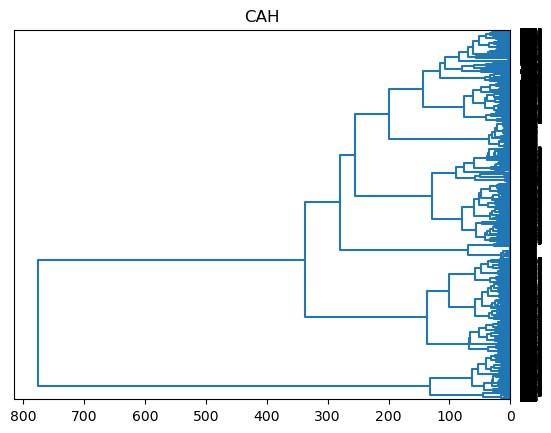

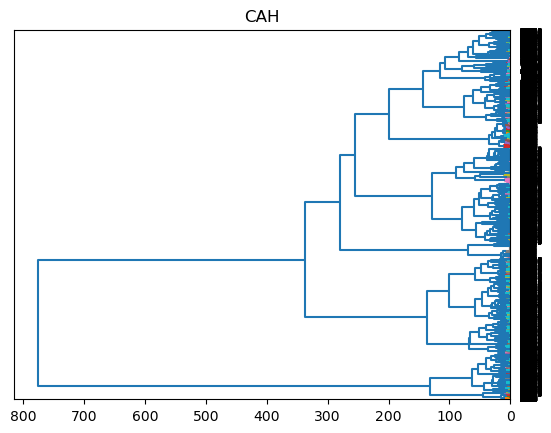

(array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
       118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
       131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
       144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
       157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169,
       170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 1

KeyboardInterrupt: 

In [59]:
#appel pour la représentation entraînée
g1,mat1 = my_cah_from_doc2vec(corpus_liste,wordsBis,seuil=10)

In [ ]:
#dimension matrice (doc x embedding)
mat1.shape

(1612, 100)

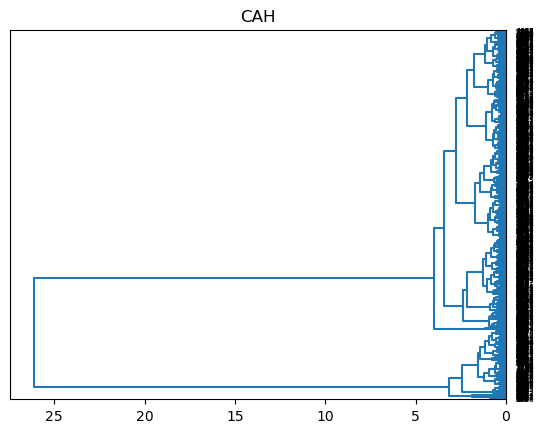

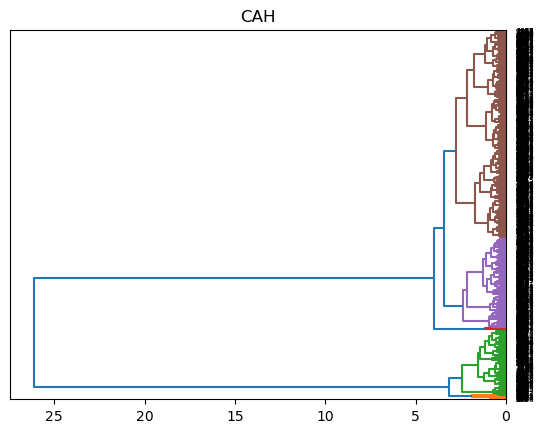

(array([1, 2, 3, 4, 5], dtype=int32), array([ 18, 286,   9, 394, 905], dtype=int64))
Dim. matrice documents-termes = (1612, 20818)

Numero du cluster = 1
Effectifs = 18
           freq
sinscrire    18
aller        18
hellowork    18
compte       18
lapp         18
accès        18
déjà         18

Numero du cluster = 2
Effectifs = 286
          freq
première   286
dintérim   286
déjà       286
accès      286
cest       286
stage      286
contenu    286

Numero du cluster = 3
Effectifs = 9
             freq
aller           9
esn             9
chez            9
lapp            9
principal       9
profil          9
télécharger     9

Numero du cluster = 4
Effectifs = 394
             freq
trouver       394
sinscrire     394
premier       394
télécharger   394
téléchargez   394
recevoir      394
hellowork     394

Numero du cluster = 5
Effectifs = 905
           freq
complétez   905
cest        905
mission     905
salaire     905
postulez    905
formation   905
déjà        905


In [ ]:
#appel pour la représentation pré-entraînée
g2,mat2 = my_cah_from_doc2vec(corpus_liste,pretrained,seuil=3.0)

In [ ]:
#croisement - vérification des cohérences des groupes
#les résultats n'ont absolument rien à voir
pandas.crosstab(g1,g2)

col_0,1,2,3,4,5
row_0,,,,,
1,1,146,0,0,0
2,0,140,0,0,0
3,0,0,0,72,57
4,0,0,0,124,91
5,0,0,0,0,68
6,0,0,0,21,163
7,0,0,0,75,201
8,3,0,0,27,161
9,0,0,0,3,155


# Rattachement doc. supp. à un groupe

In [ ]:
#la feinte : indi. supp. appartient à la base en réalité
num_supp = 10

In [ ]:
#document supplémentaire
docSupp = corpus_original[num_supp]
docSupp

"Offre Emploi CDD Statisticien Marseille (13) - Recrutement par Chez Switch | Hellowork Aller au contenu principal Complétez votre profil pour recevoir des offres adaptées. Mon espace Mes CV vus Mes candidatures Mes alertes Mon profil Paramètres Déconnexion Missions d'intérim Offres de stage Offres en alternance Créer mon alerte Déposer mon CV Salaire brut net Téléchargez l'app et postulez dans les premiers ! Diffuser ma première offre Déjà client Téléchargez l'app et postulez dans les premiers ! Se connecter S'inscrire Emploi Formation Accès recruteur Téléchargez l'app et postulez dans les premiers ! Trouver mon j ob s Trouver mon e ntreprise s Accès recruteur Diffuser ma première offre Déjà client Télécharger l’app Emploi Missions d'intérim Offres de stage Offres en alternance Créer mon alerte Déposer mon CV Salaire brut net Formation Emploi Emploi Mon compte Se connecter Mon compte S'inscrire Mon espace Mes CV vus Mes candidatures Mes alertes Mon profil Paramètres Déconnexion Mon es

In [ ]:
#à nettoyer
docSuppClean = nettoyage_doc(docSupp)
docSuppClean

['offre',
 'emploi',
 'cdd',
 'statisticien',
 'marseille',
 'recrutement',
 'chez',
 'switch',
 'hellowork',
 'aller',
 'contenu',
 'principal',
 'complétez',
 'profil',
 'recevoir',
 'offres',
 'adaptées',
 'espace',
 'vus',
 'candidature',
 'alertes',
 'profil',
 'paramètres',
 'déconnexion',
 'mission',
 'dintérim',
 'offres',
 'stage',
 'offres',
 'alternance',
 'créer',
 'alerte',
 'déposer',
 'salaire',
 'brut',
 'net',
 'téléchargez',
 'lapp',
 'postulez',
 'premier',
 'diffuser',
 'première',
 'offre',
 'déjà',
 'client',
 'téléchargez',
 'lapp',
 'postulez',
 'premier',
 'connecter',
 'sinscrire',
 'emploi',
 'formation',
 'accès',
 'recruteur',
 'téléchargez',
 'lapp',
 'postulez',
 'premier',
 'trouver',
 'trouver',
 'ntreprise',
 'accès',
 'recruteur',
 'diffuser',
 'première',
 'offre',
 'déjà',
 'client',
 'télécharger',
 'app',
 'emploi',
 'mission',
 'dintérim',
 'offres',
 'stage',
 'offres',
 'alternance',
 'créer',
 'alerte',
 'déposer',
 'salaire',
 'brut',
 'net',

In [ ]:
#coordonnées
coordSupp = my_doc_2_vec(docSuppClean, wordsBis)
coordSupp

array([ 2.16076629e-01, -5.04675579e-01, -6.09906097e-01,  5.61191257e-01,
       -6.55113874e-01,  6.92502159e-01,  1.24379742e+00,  5.29819268e-01,
       -5.60670785e-01,  4.07610814e-01,  2.53814520e-01,  1.13004380e+00,
       -5.83071858e-01, -4.81359680e-01,  1.52031170e-01,  2.56665101e-01,
        8.15003518e-02,  1.19931894e-01, -5.01378130e-01,  3.18195965e-01,
       -1.54570003e-01, -2.13238321e-01,  1.52448341e-02,  4.85180610e-01,
       -3.54924725e-01,  7.05157825e-01, -4.81326016e-01, -4.86607040e-01,
        8.98466764e-01,  4.06282120e-02, -2.94383786e-01, -2.26646304e-01,
       -4.31811702e-01,  2.94972389e-01,  3.43552169e-01, -5.17924879e-01,
        3.02794585e-01,  1.38381932e-01,  8.67044923e-02,  2.34513862e-01,
       -2.54534832e-01, -1.60909140e-01, -2.63019567e-01, -4.01988073e-01,
       -5.71586812e-01,  4.53564415e-01,  2.68430075e-01,  8.54492936e-01,
        2.24385396e-01,  2.72079572e-01,  1.04028388e-03, -3.89087999e-01,
       -1.15646998e-01,  

In [ ]:
#transformer la matrice de coord. en data frame
dfMat = pandas.DataFrame(mat1)
dfMat.shape

(1612, 100)

In [ ]:
#calculer les moyennes conditionnelles
gb = dfMat.groupby(by=g1)
groups_mean = gb.mean()
groups_mean

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
1,-0.312509,-0.101544,0.512915,-0.044742,-0.108534,-0.661926,0.349079,1.206031,-0.429669,0.601450,...,-0.072117,-0.097628,-0.917259,0.204241,0.593444,-0.203112,-0.448158,-0.866979,-0.192669,-0.409460
2,-0.319492,-0.055781,0.612435,-0.124520,0.020186,-0.860419,0.193989,1.336673,-0.394331,0.561389,...,-0.036302,-0.009605,-1.065540,0.340077,0.783512,-0.108782,-0.517768,-1.005157,-0.084218,-0.537117
3,0.276740,-0.389991,-0.202015,0.520863,-0.637774,0.596123,1.196970,0.325877,-0.359534,-0.029988,...,-0.802892,-0.470138,0.060349,-0.130965,0.192729,-0.441765,0.300443,0.215433,-0.651203,0.213734
4,0.301059,-0.413016,-0.167254,0.451645,-0.688298,0.568771,1.223244,0.361867,-0.478514,0.150586,...,-0.695219,-0.397715,-0.076686,-0.077274,0.122534,-0.444650,0.325398,0.145083,-0.630643,0.060410
5,0.144910,-0.468114,-0.053632,0.310965,-0.884684,0.413363,0.895397,0.148506,-0.216487,-0.530593,...,-0.587372,-0.331224,-0.055582,0.135555,-0.071475,-0.226847,0.272723,-0.093408,-0.379396,0.342689
6,0.274657,-0.429594,-0.099941,0.397353,-0.771732,0.533764,1.052105,0.277730,-0.207537,-0.311979,...,-0.663011,-0.464094,0.077182,-0.006931,-0.027229,-0.350498,0.260224,0.107160,-0.488399,0.359637
7,0.289163,-0.421837,-0.085837,0.400029,-0.856446,0.506016,1.158559,0.305933,-0.542017,0.181244,...,-0.617016,-0.242348,-0.190578,0.082649,-0.051225,-0.427854,0.311616,-0.076826,-0.571752,-0.041361
8,0.323512,-0.533967,-0.116772,0.324401,-0.771243,0.461790,1.095570,0.306878,-0.460659,-0.079142,...,-0.715469,-0.277058,-0.151587,0.049951,0.007470,-0.306605,0.249725,-0.023870,-0.499668,0.076091
9,0.168785,-0.373158,-0.077493,0.403591,-0.914000,0.545847,0.996163,0.240811,-0.365882,-0.127618,...,-0.625756,-0.309777,-0.105899,0.053734,-0.014474,-0.346610,0.272053,-0.094156,-0.535053,0.178397
10,0.356965,-0.649583,-0.314941,0.495798,-0.681095,0.537625,1.289385,0.653738,-0.582010,0.563192,...,-0.870643,-0.377393,-0.108471,-0.124654,0.167256,-0.562566,0.014188,0.004232,-0.691417,-0.086812


In [ ]:
#si on passe par pivot_table
pandas.pivot_table(dfMat,index=g1,aggfunc="mean")

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
1,-0.312509,-0.101544,0.512915,-0.044742,-0.108534,-0.661926,0.349079,1.206031,-0.429669,0.601450,...,-0.072117,-0.097628,-0.917259,0.204241,0.593444,-0.203112,-0.448158,-0.866979,-0.192669,-0.409460
2,-0.319492,-0.055781,0.612435,-0.124520,0.020186,-0.860419,0.193989,1.336673,-0.394331,0.561389,...,-0.036302,-0.009605,-1.065540,0.340077,0.783512,-0.108782,-0.517768,-1.005157,-0.084218,-0.537117
3,0.276740,-0.389991,-0.202015,0.520863,-0.637774,0.596123,1.196970,0.325877,-0.359534,-0.029988,...,-0.802892,-0.470138,0.060349,-0.130965,0.192729,-0.441765,0.300443,0.215433,-0.651203,0.213734
4,0.301059,-0.413016,-0.167254,0.451645,-0.688298,0.568771,1.223244,0.361867,-0.478514,0.150586,...,-0.695219,-0.397715,-0.076686,-0.077274,0.122534,-0.444650,0.325398,0.145083,-0.630643,0.060410
5,0.144910,-0.468114,-0.053632,0.310965,-0.884684,0.413363,0.895397,0.148506,-0.216487,-0.530593,...,-0.587372,-0.331224,-0.055582,0.135555,-0.071475,-0.226847,0.272723,-0.093408,-0.379396,0.342689
6,0.274657,-0.429594,-0.099941,0.397353,-0.771732,0.533764,1.052105,0.277730,-0.207537,-0.311979,...,-0.663011,-0.464094,0.077182,-0.006931,-0.027229,-0.350498,0.260224,0.107160,-0.488399,0.359637
7,0.289163,-0.421837,-0.085837,0.400029,-0.856446,0.506016,1.158559,0.305933,-0.542017,0.181244,...,-0.617016,-0.242348,-0.190578,0.082649,-0.051225,-0.427854,0.311616,-0.076826,-0.571752,-0.041361
8,0.323512,-0.533967,-0.116772,0.324401,-0.771243,0.461790,1.095570,0.306878,-0.460659,-0.079142,...,-0.715469,-0.277058,-0.151587,0.049951,0.007470,-0.306605,0.249725,-0.023870,-0.499668,0.076091
9,0.168785,-0.373158,-0.077493,0.403591,-0.914000,0.545847,0.996163,0.240811,-0.365882,-0.127618,...,-0.625756,-0.309777,-0.105899,0.053734,-0.014474,-0.346610,0.272053,-0.094156,-0.535053,0.178397
10,0.356965,-0.649583,-0.314941,0.495798,-0.681095,0.537625,1.289385,0.653738,-0.582010,0.563192,...,-0.870643,-0.377393,-0.108471,-0.124654,0.167256,-0.562566,0.014188,0.004232,-0.691417,-0.086812


In [ ]:
#calcul de la similarité avec l'individu supplémentaire
simSupp = groups_mean.apply(lambda x : my_cosinus(x,coordSupp),axis=1)
simSupp

1     0.232528
2     0.115474
3     0.931080
4     0.948595
5     0.778396
6     0.845942
7     0.901067
8     0.914282
9     0.866614
10    0.938843
11    0.713576
dtype: float64

In [ ]:
#groupe de rattachement
groups_mean.index[numpy.argmax(simSupp)]

#vérification puisque c'est un individu de la base en réalité
g1[num_supp]

10

# Traitement du corpus FAVORITE

/!\ Attention pour le traitement de FAVORITE -- Certains documents sont vides (il n'y a rien entre les balises). Il faut les retirer du corpus avant de lancer l'analyse.